# Analysis of eight-probe Neuropixel recordings of spontaneous neural activity in mice (week 15-16)
---
### Tasks
- plot distance matrices for all neurons using CCF coordinates
- experiment with Ripserer

In [1]:
using Plots, Measures; gr()
using MAT, Printf
using LinearAlgebra, Statistics, Random
using Clustering, Distances
using InformationMeasures
using Ripserer
using BenchmarkTools

In [3]:
# Load all data in a three-element array of dictionaries
# Each element corresponding to each mouse maps variable names to their contents  
mice_names = ["Krebs", "Waksman", "Robbins"]
data = [MAT.matread("../Data/source/$(mice_names[i])withFaces_KS2.mat") for i in 1:3];

### All-neuron plots 

In [4]:
function corClust(cmat, mtr, lnk)
    sym2func = Dict(:CosD => Distances.CosineDist(), :EucD => Distances.Euclidean())
    
    if mtr == :None
        clust_idx = 1:size(cmat, 1)
    else
        diss_mat = Distances.pairwise(sym2func[mtr], cmat, dims=1)
        result = Clustering.hclust(diss_mat, linkage=lnk)
        clust_idx = result.order
    end
    
    return clust_idx
end


function diff(v, binary=false)
    rep_mat = repeat(v, 1, length(v))
    diff_mat = abs.(rep_mat - transpose(rep_mat))
    
    if binary
        diff_mat = diff_mat .!= 0
    end
    
    return diff_mat
end

function mutualInfo(st)
    n = size(st, 1)
    mi_mat = zeros(n, n)
    
    for i=1:n-1
        for j=i+1:n
            mi_mat[i, j] = InformationMeasures.get_mutual_information(st[i, :], st[j, :])
        end
    end
    
    mi_mat = mi_mat + transpose(mi_mat)
    
    for i=1:n
        mi_mat[i, i] = InformationMeasures.get_entropy(st[i, :])
    end
    
    return log.(mi_mat)
end


function spkCorCompare(data, id, link=:none, metric=:none, byprobe=false)
    spktrain = data[id]["stall"]          # multi-neuron spike train matrix
    hop = data[id]["Wh"]                  # heights of neurons on probes
    coord = data[id]["ccfCoords"]         # CCF coordinates of neurons
    loc = data[id]["brainLoc"]            # index labels of brain areas
     
    if byprobe
        probe_ids = data[id]["iprobe"]      # IDs of corresponding probes
        plot_array = Array{Plots.Plot{Plots.GRBackend}}(undef, 8*3)
        
        for i=1:8
            extract_idx = vec(probe_ids .== i)
            cor_mat_iprobe = Statistics.cor(spktrain[extract_idx, :], dims=2)
            if link == :none || metric == :none
                clust_idx = sortperm(hop[extract_idx])
            else
                clust_idx = corClust(cor_mat_iprobe, metric, link)
            end
            dist_mat_iprobe = diff(hop[extract_idx])
            logmi_mat_iprobe = mutualInfo(spktrain[extract_idx, :])
            
            plot_array[i*3-1] = heatmap(cor_mat_iprobe[clust_idx, clust_idx], clim=(-0.5, 1), title="M$id-P$i-cor-$metric")         
            plot_array[i*3-2] = heatmap(dist_mat_iprobe[clust_idx, clust_idx], clim=(0, 4000), title="M$id-P$i-dist-$metric")
            plot_array[i*3] = heatmap(logmi_mat_iprobe[clust_idx, clust_idx], clim=(-20, 2.5), title="M$id-P$i-logmi-$metric")
        end
        
        display(plot(plot_array[1:12]..., layout=(4,3), size=(1500, 1500), yflip=true))
        #savefig("../../Plots/M$(id)_P1-4_$(metric)-$(link).png")
        display(plot(plot_array[13:24]..., layout=(4,3), size=(1500, 1500), yflip=true))
        #savefig("../../Plots/M$(id)_P5-8_$(metric)-$(link).png")
        
    else
        cor_mat_all = Statistics.cor(spktrain, dims=2)
        if link == :none || metric == :none
            clust_idx = sortperm(vec(loc))
        else
            clust_idx = corClust(cor_mat_all, metric, link)
        end
        logmi_mat_all = mutualInfo(spktrain)
        dist_mat_all = Distances.pairwise(Distances.Euclidean(), coord, dims=1)
        locdiff_mat_all = diff(loc, true)
        
        p1 = heatmap(cor_mat_all[clust_idx, clust_idx], clim=(-0.3, 1), title="M$id-all-cor-$metric-$link")
        p2 = heatmap(logmi_mat_all[clust_idx, clust_idx], clim=(-20, 1.1), title="M$id-all-logmi-$metric-$link")
        p3 = heatmap(dist_mat_all[clust_idx, clust_idx], clim=(0, 6050), title="M$id-all-dist-$metric-$link")
        p4 = heatmap(locdiff_mat_all[clust_idx, clust_idx], title="M$id-all-locdiff-$metric-$link")
        plot(p1, p2, p3, p4, layout=(2, 2), size=(1450, 1200), yflip=true)
        #savefig("./Plots/M$(id)_all_$(metric)-$(link).png")
    end
end

spkCorCompare (generic function with 4 methods)

In [5]:
spkCorCompare(data, 1)

In [6]:
spkCorCompare(data, 2)

In [ ]:
spkCorCompare(data, 3)

### Experiment with Ripser

In [111]:
function TDARipser(data, id, metric)
    MAX_DIM = 1
    valid = true
    
    if metric == :corr
        spktrain = data[id]["stall"]
        cor_mat = Statistics.cor(spktrain, dims=2)
        diss_mat = 1 .- cor_mat
        result = ripserer(diss_mat, dim_max=MAX_DIM)
    elseif metric == :dist
        coord = data[id]["ccfCoords"]
        dist_mat = Distances.pairwise(Distances.Euclidean(), coord, dims=1)
        dist_mat = dist_mat .+ 1
        result = ripserer(dist_mat, dim_max=MAX_DIM)
    else
        println("Invalid metric")
        valid = false
    end

    if valid
        p1 = Ripserer.barcode(result)
        p2 = plot(result)
        plot(p1, p2, layout=grid(1, 2, widths=[0.75, 0.25]), size=(1400, 400), margin=5mm)
        #savefig("./Plots/barcode_m$(id).png")
    end
end

TDARipser (generic function with 2 methods)

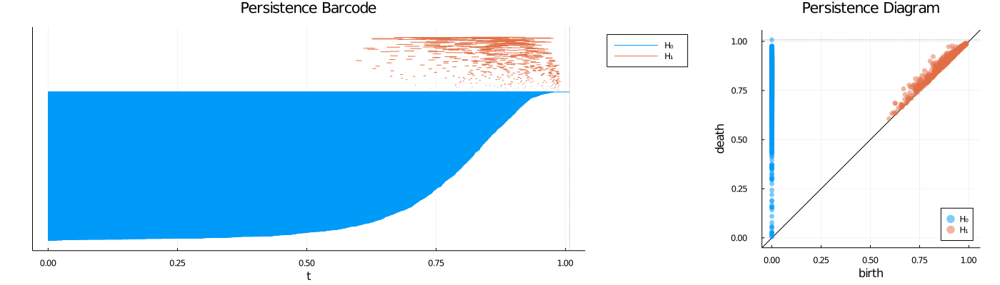

In [112]:
TDARipser(data, 1, :corr)

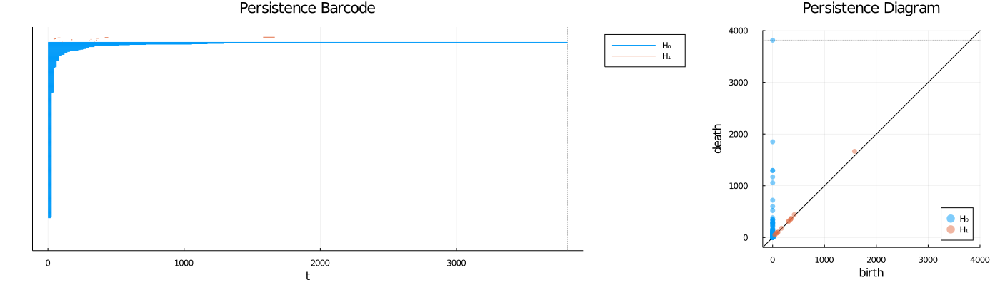

In [113]:
TDARipser(data, 1, :dist)

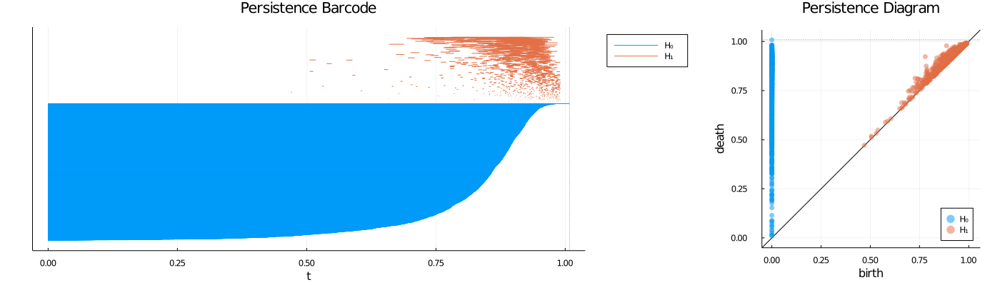

In [114]:
TDARipser(data, 2, :corr)

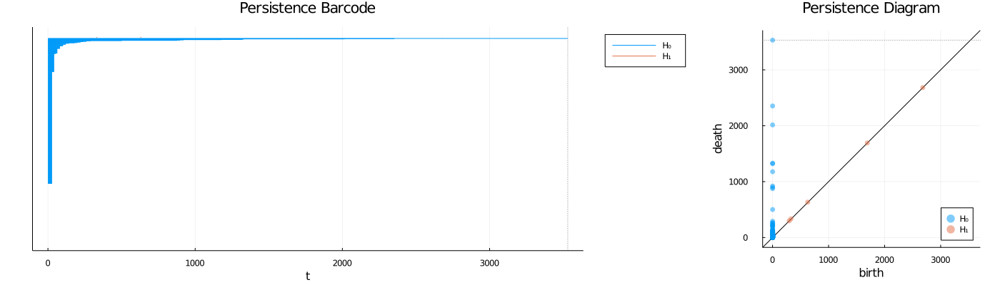

In [115]:
TDARipser(data, 2, :dist)

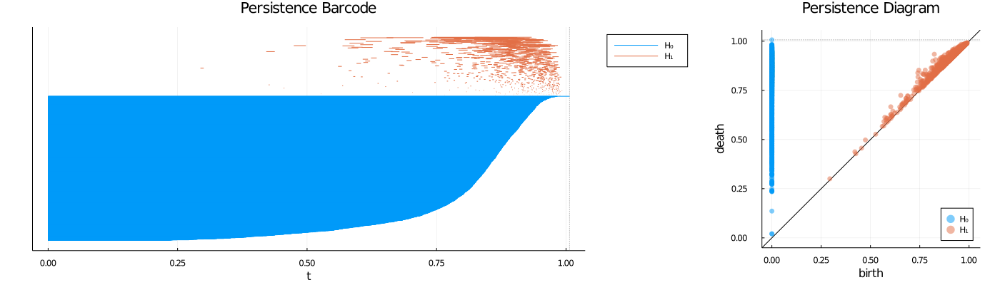

In [116]:
TDARipser(data, 3, :corr)

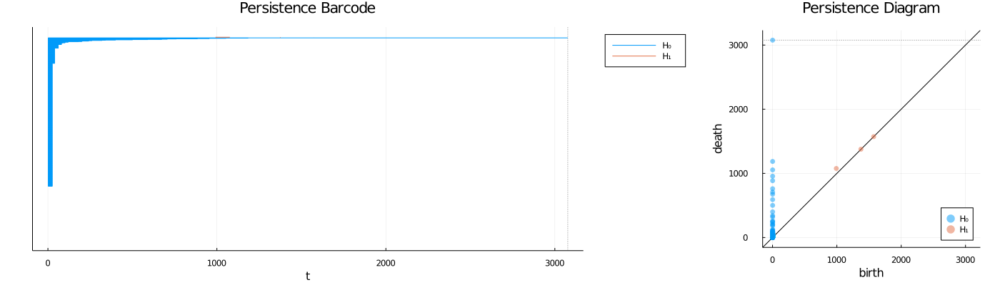

In [117]:
TDARipser(data, 3, :dist)